# Import libraries

In [1]:
import pandas as pd
import warnings
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler    

import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")

# Import datasets

In [2]:
df = pd.read_csv('data/dwh.csv')
# df.columns

# Exploring dataset

In [3]:
df.head(10)

,followers,artist_10,artist_1,track_id,artist_19,artist_popularity,instrumentalness,artist_4,artist_id,artist_42,...,artist_40,artist_34,artist_28,release_date,album_popularity,artist_16,artist_22,genre_9,artist_37,genre_0
0,8050,NaN,NaN,6l0opGkMI0sbJesy0CSrXI,NaN,32,0.898,NaN,72fQWyXObQBgUIUejMo6js,NaN,...,NaN,NaN,NaN,2019-09-27,18,NaN,NaN,NaN,NaN,piano cover
1,4,NaN,NaN,30MlrZvVDfnnTpcsXD1EQG,NaN,1,0.870,NaN,3z9EcdQww1DltB1WRSv0mF,NaN,...,NaN,NaN,NaN,2024-06-13,2,NaN,NaN,NaN,NaN,NaN
2,212,NaN,NaN,11XFgY1LUrdxeO02QX4jtg,NaN,2,0.916,NaN,58aiFDi9qSaoPfUlpi4kd3,NaN,...,NaN,NaN,NaN,2013-09-27,1,NaN,NaN,NaN,NaN,NaN
3,118,NaN,NaN,6apK6ZLfKQDIk8NjxpCkDD,NaN,0,0.000,NaN,2a05PhYL7NCpSYFZnysrf1,NaN,...,NaN,NaN,NaN,2002-01-01,0,NaN,NaN,NaN,NaN,NaN
4,7656055,NaN,NaN,29G79ZezjVS7rk9n1gitBN,NaN,74,0.000,NaN,7gOdHgIoIKoe4i9Tta6qdD,NaN,...,NaN,NaN,NaN,2019-05-09,53,NaN,NaN,NaN,NaN,boy band
5,225,NaN,NaN,6QqfGAdkEPO4vdY3020YDH,NaN,4,0.000,NaN,1N1oFUePNKTlaTy5E7rgyk,NaN,...,NaN,NaN,NaN,2012-03-12,9,NaN,NaN,NaN,NaN,NaN
6,883,NaN,NaN,4dYwjDRtMVSFNuS2fC3aqr,NaN,10,0.459,NaN,2xfUm2zfpSXaKcrTgd4hmp,NaN,...,NaN,NaN,NaN,2023-10-11,9,NaN,NaN,NaN,NaN,NaN
7,153,NaN,NaN,0711f7f1aOKyW4Zpoag5n4,NaN,0,0.791,NaN,688VK2vkKy4yV0eTfMpn1e,NaN,...,NaN,NaN,NaN,2014-01-07,0,NaN,NaN,NaN,NaN,NaN
8,17,NaN,NaN,67OeI5pyigwN7L4Qg68VzR,NaN,0,0.923,NaN,7KDX7LFm1Y068SDBUyDepN,NaN,...,NaN,NaN,NaN,2024-07-12,2,NaN,NaN,NaN,NaN,NaN
9,49,NaN,NaN,7sqwRCY7MEzPptPNqJyiKY,NaN,0,0.000,NaN,433NiNdlNVl7aiJiFSsdA2,NaN,...,NaN,NaN,NaN,2013-07-17,0,NaN,NaN,NaN,NaN,NaN


In [4]:
# Selecting relevant features

df = df[['artists','artist_genres','track_name','explicit','release_date','duration_sec',
 'track_popularity','followers','album_name','album_popularity','label',
 'tempo','danceability','loudness','energy','instrumentalness',
 'acousticness','valence','speechiness','liveness',
 'mode','key','time_signature']]

df.head(20)




,artists,artist_genres,track_name,explicit,release_date,duration_sec,track_popularity,followers,album_name,album_popularity,...,loudness,energy,instrumentalness,acousticness,valence,speechiness,liveness,mode,key,time_signature
0,['Molotov Cocktail Piano'],['piano cover'],Soon You'Ll Get Better - Instrumental,False,2019-09-27,199.793,9,8050,Mcp Performs Taylor Swift: Lover (Instrumental),18,...,-17.359,0.1570,0.898000,0.983000,0.318,0.0361,0.1110,1,0,4
1,['zombiesoblessed'],[],Beyond (Interlude),False,2024-06-13,127.509,2,4,Jeremy & The Boyz,2,...,-11.067,0.5340,0.870000,0.035100,0.081,0.0806,0.3880,1,2,4
2,['Jeremy Choi'],[],Do You Think Of Me,False,2013-09-27,240.092,0,212,At The Door,1,...,-28.440,0.0277,0.916000,0.995000,0.345,0.0860,0.1060,1,5,4
3,['The One-Eyed Show'],[],Tree Top Toby,False,2002-01-01,191.893,0,118,Unsure Of Direction,0,...,-5.242,0.8980,0.000000,0.569000,0.964,0.0322,0.2210,1,7,4
4,['Joe Jonas'],"['boy band', 'pop']",Just In Love,False,2019-05-09,207.440,15,7656055,Music From Chasing Happiness,53,...,-5.696,0.8670,0.000000,0.002870,0.661,0.0364,0.0739,0,5,4
5,['Andra Moran'],[],Hallelujah Once Again,False,2012-03-12,126.026,0,225,Little Miracles,9,...,-8.514,0.4860,0.000000,0.802000,0.741,0.0480,0.0909,1,2,4
6,['ArianaRealTV'],[],I'M Gonna Eat & Lick Your Delicious Mic Pt.3,False,2023-10-11,205.605,7,883,I'M Gonna Eat & Lick Your Delicious Mic,9,...,-22.217,0.0999,0.459000,0.001590,0.184,0.2950,0.1210,1,1,3
7,['Boy Band Nation'],[],I Wish (Instrumental Version),False,2014-01-07,214.543,0,153,Best Song Ever Tribute To One Direction,0,...,-5.458,0.7600,0.791000,0.004460,0.445,0.0383,0.1850,1,7,4
8,['Zeb Newby'],[],Jeremy'S Disgrace,False,2024-07-12,222.411,0,17,Jeremy Pimpernickel,2,...,-9.800,0.7170,0.923000,0.253000,0.253,0.0437,0.1030,0,5,4
9,['Ameritz - Tribtues'],[],What Makes You Beautiful,False,2013-07-17,207.496,0,49,One Way Or Another - A Tribute To One Direction,0,...,-5.468,0.5990,0.000000,0.437000,0.932,0.1090,0.0584,1,4,4


In [5]:
# Removing symbols from artists names
df['artists'] = df['artists'].str.replace(r"['\[\]]", '', regex=True)

In [6]:
df

,artists,artist_genres,track_name,explicit,release_date,duration_sec,track_popularity,followers,album_name,album_popularity,...,loudness,energy,instrumentalness,acousticness,valence,speechiness,liveness,mode,key,time_signature
0,Molotov Cocktail Piano,['piano cover'],Soon You'Ll Get Better - Instrumental,False,2019-09-27,199.793,9,8050,Mcp Performs Taylor Swift: Lover (Instrumental),18,...,-17.359,0.1570,0.8980,0.98300,0.318,0.0361,0.1110,1,0,4
1,zombiesoblessed,[],Beyond (Interlude),False,2024-06-13,127.509,2,4,Jeremy & The Boyz,2,...,-11.067,0.5340,0.8700,0.03510,0.081,0.0806,0.3880,1,2,4
2,Jeremy Choi,[],Do You Think Of Me,False,2013-09-27,240.092,0,212,At The Door,1,...,-28.440,0.0277,0.9160,0.99500,0.345,0.0860,0.1060,1,5,4
3,The One-Eyed Show,[],Tree Top Toby,False,2002-01-01,191.893,0,118,Unsure Of Direction,0,...,-5.242,0.8980,0.0000,0.56900,0.964,0.0322,0.2210,1,7,4
4,Joe Jonas,"['boy band', 'pop']",Just In Love,False,2019-05-09,207.440,15,7656055,Music From Chasing Happiness,53,...,-5.696,0.8670,0.0000,0.00287,0.661,0.0364,0.0739,0,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36375,iSingKeys,[],Perfect (Lower Key - Originally Performed By E...,False,2020-05-18,283.099,0,565,Perfect (Originally Performed By Ed Sheeran) [...,0,...,-19.185,0.1200,0.9650,0.99500,0.207,0.0780,0.1090,1,6,3
36376,Mix Boy,[],Little Bitz,False,2024-06-20,351.778,0,10,Little Bitz,0,...,-5.158,0.8850,0.8320,0.76800,0.976,0.0565,0.0608,1,0,4
36377,BTS Chitlom,[],Bounce Boom,False,2015-11-06,303.750,0,509,Bunce Boom,0,...,-3.171,0.9470,0.0383,0.04030,0.819,0.1300,0.0433,1,0,4
36378,Olivia Watso,[],Finally,False,2023-04-18,69.636,25,36,Mind,29,...,-20.501,0.0966,0.8980,0.89500,0.224,0.0493,0.1080,0,5,4


In [7]:
# Processing artists genres to fit the purpose of the project
import ast

list_of_lists = [ast.literal_eval(s) for s in df['artist_genres']]
df['artist_genres'] = [sublist[0] if sublist else None for sublist in list_of_lists]
df['artist_genres'].fillna("unknown", inplace=True)
# df['label'].fillna("unknown", inplace=True)

In [8]:
df.info() # Summary of DataFrame information


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36380 entries, 0 to 36379
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artists           36380 non-null  object 
 1   artist_genres     36380 non-null  object 
 2   track_name        36380 non-null  object 
 3   explicit          36380 non-null  bool   
 4   release_date      36380 non-null  object 
 5   duration_sec      36380 non-null  float64
 6   track_popularity  36380 non-null  int64  
 7   followers         36380 non-null  int64  
 8   album_name        36380 non-null  object 
 9   album_popularity  36380 non-null  int64  
 10  label             36378 non-null  object 
 11  tempo             36380 non-null  float64
 12  danceability      36380 non-null  float64
 13  loudness          36380 non-null  float64
 14  energy            36380 non-null  float64
 15  instrumentalness  36380 non-null  float64
 16  acousticness      36380 non-null  float6

In [9]:

print('\nNumber of unique values in each column')
for i in df.columns:
    print(f'{i} - {df[i].nunique()}')



Number of unique values in each column
artists - 6870
artist_genres - 575
track_name - 24113
explicit - 2
release_date - 2966
duration_sec - 24691
track_popularity - 96
followers - 2439
album_name - 7287
album_popularity - 96
label - 4117
tempo - 21378
danceability - 976
loudness - 16746
energy - 1973
instrumentalness - 4331
acousticness - 3676
valence - 1571
speechiness - 1424
liveness - 1581
mode - 2
key - 12
time_signature - 5


In [10]:

print('\nNumber of missing values in each column\n', df.isnull().sum())



Number of missing values in each column
 artists             0
artist_genres       0
track_name          0
explicit            0
release_date        0
duration_sec        0
track_popularity    0
followers           0
album_name          0
album_popularity    0
label               2
tempo               0
danceability        0
loudness            0
energy              0
instrumentalness    0
acousticness        0
valence             0
speechiness         0
liveness            0
mode                0
key                 0
time_signature      0
dtype: int64


In [11]:

print('\nNumber of duplicated rows\n', df.duplicated().sum())


Number of duplicated rows
 9


In [12]:
# Drop duplicates
df.drop_duplicates(inplace=True)

In [13]:
# Setting value type to integer
df['explicit'] = df['explicit'].astype(int)
df['release_date'] = pd.to_datetime(df['release_date'])
# df['release_date'] = df['release_date'].astype()

In [14]:
# Applying Label Encoder to artist genre values
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
df['artist_genres_encoded'] = label_encoder.fit_transform(df['artist_genres'])

In [15]:
df.describe()

,explicit,release_date,duration_sec,track_popularity,followers,album_popularity,tempo,danceability,loudness,energy,instrumentalness,acousticness,valence,speechiness,liveness,mode,key,time_signature,artist_genres_encoded
count,36371.000000,36371,36371.000000,36371.000000,3.637100e+04,36371.000000,36371.000000,36371.000000,36371.000000,36371.000000,36371.000000,36371.000000,36371.00000,36371.000000,36371.000000,36371.000000,36371.000000,36371.000000,36371.000000
mean,0.087570,2019-01-06 10:28:17.110334976,206.912052,10.868659,9.073538e+06,16.105194,120.674385,0.593760,-11.738138,0.474274,0.374055,0.441163,0.43421,0.091307,0.164777,0.673916,5.113992,3.902395,452.784389
min,0.000000,1958-04-07 00:00:00,3.613000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2016-03-11 00:00:00,162.000000,0.000000,4.280000e+02,0.000000,95.950000,0.494000,-15.349000,0.255000,0.000000,0.044100,0.23200,0.037400,0.095800,0.000000,2.000000,4.000000,381.000000
50%,0.000000,2020-12-04 00:00:00,203.081000,1.000000,3.639000e+03,6.000000,120.008000,0.608000,-10.066000,0.468000,0.018500,0.349000,0.40700,0.049900,0.114000,1.000000,5.000000,4.000000,561.000000
75%,0.000000,2023-03-29 00:00:00,240.106000,15.000000,6.974700e+04,23.000000,139.996500,0.713000,-6.785500,0.696000,0.880000,0.869000,0.61800,0.082000,0.174000,1.000000,8.000000,4.000000,561.000000
max,1.000000,2024-08-16 00:00:00,4728.560000,100.000000,1.181012e+08,100.000000,248.123000,0.994000,1.835000,1.000000,0.997000,0.996000,1.00000,0.966000,0.991000,1.000000,11.000000,5.000000,574.000000
std,0.282672,NaN,103.045769,17.607452,2.811861e+07,22.024851,31.308036,0.162577,6.564097,0.265819,0.422533,0.387726,0.24536,0.123124,0.134826,0.468785,3.523523,0.445659,158.904911


In [16]:
# Reseting dataframe index
df.reset_index(drop=True, inplace=True)

# Exploratory Data Analysis (EDA)


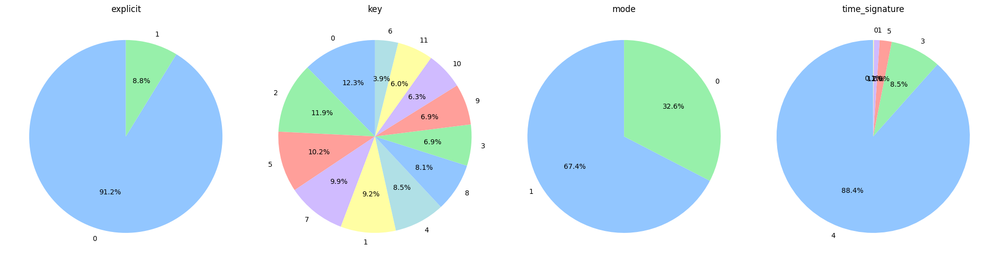

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-v0_8-pastel')
colors = sns.color_palette('viridis')

fig, axes = plt.subplots(1, 4, figsize=(20,10))  # 1 row, 4 columns

for i, name in enumerate(['explicit', 'key', 'mode', 'time_signature']):
    axes[i].pie(df[name].value_counts(), labels=df[name].unique(), autopct='%1.1f%%', startangle=90)
    axes[i].set_title(f'{name}')

# Display the plot
plt.tight_layout()
plt.show()

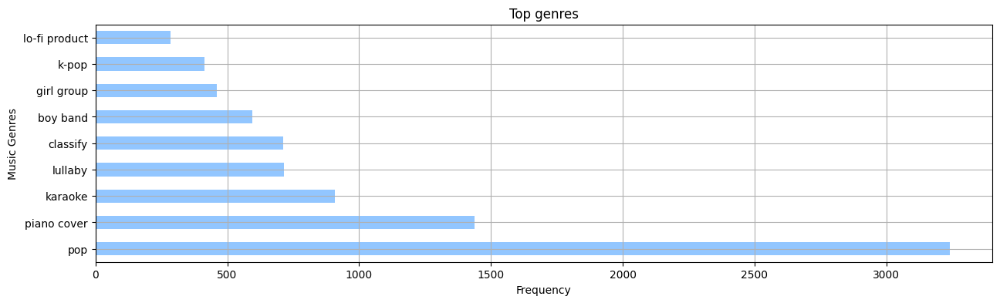

In [18]:
#Top 10 genres based on frequency
plt.figure(figsize=(15, 4))
df['artist_genres'].value_counts().head(10).iloc[1:].plot(kind='barh',title='Top genres')
plt.xlabel('Frequency')
plt.ylabel('Music Genres')
plt.grid(True)
plt.show()

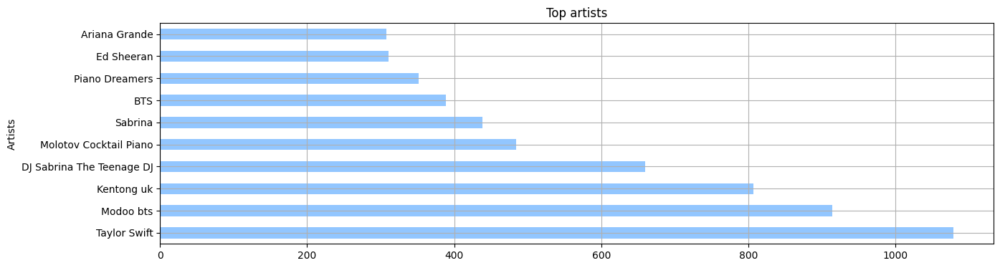

In [19]:
#Top 10 artists based on frequency 
plt.figure(figsize=(15, 4))
df['artists'].value_counts().head(10).plot(kind='barh',title='Top artists')
plt.ylabel('Artists')
plt.grid(True)
plt.show()

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36371 entries, 0 to 36370
Data columns (total 24 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   artists                36371 non-null  object        
 1   artist_genres          36371 non-null  object        
 2   track_name             36371 non-null  object        
 3   explicit               36371 non-null  int64         
 4   release_date           36371 non-null  datetime64[ns]
 5   duration_sec           36371 non-null  float64       
 6   track_popularity       36371 non-null  int64         
 7   followers              36371 non-null  int64         
 8   album_name             36371 non-null  object        
 9   album_popularity       36371 non-null  int64         
 10  label                  36369 non-null  object        
 11  tempo                  36371 non-null  float64       
 12  danceability           36371 non-null  float64       
 13  l

In [21]:
# continuous variables in df
continuous_vars = [col for col in df.select_dtypes(include=['float64', 'int64']).columns]
continuous_vars

['explicit',
 'duration_sec',
 'track_popularity',
 'followers',
 'album_popularity',
 'tempo',
 'danceability',
 'loudness',
 'energy',
 'instrumentalness',
 'acousticness',
 'valence',
 'speechiness',
 'liveness',
 'mode',
 'key',
 'time_signature',
 'artist_genres_encoded']

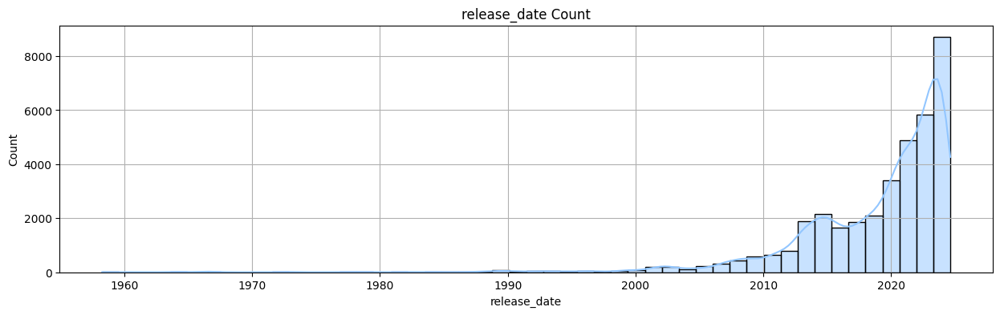

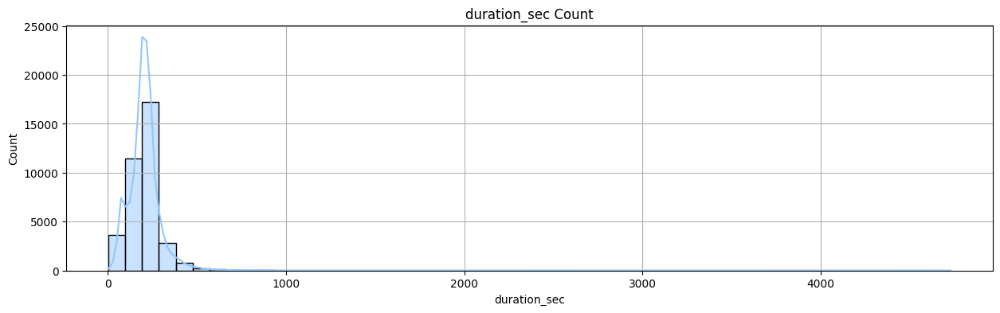

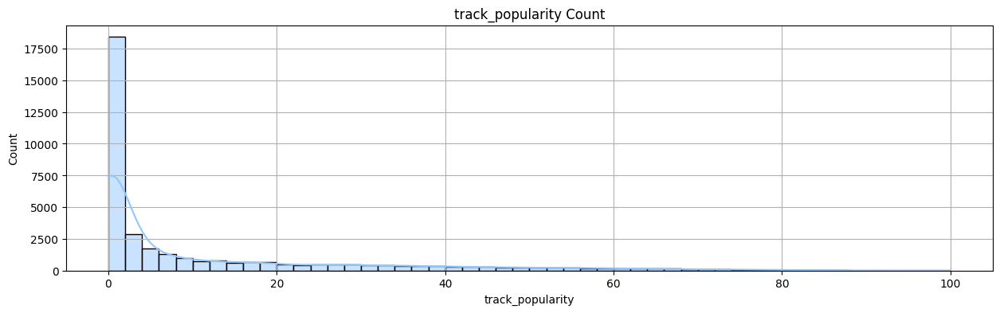

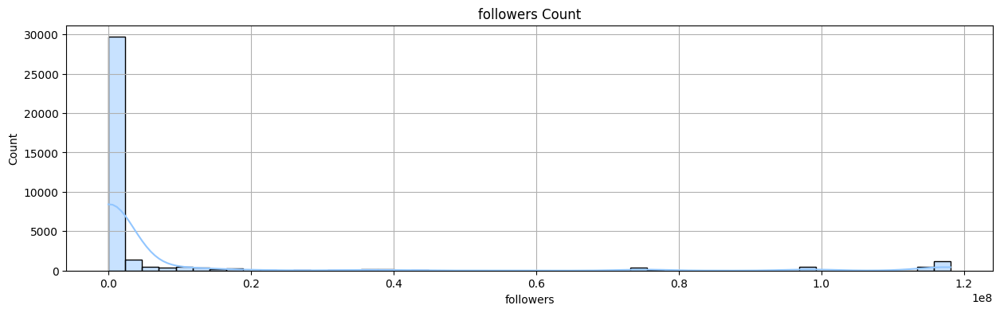

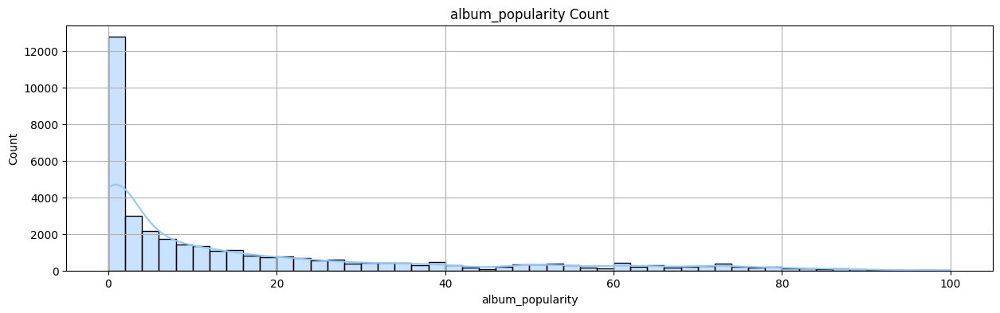

...

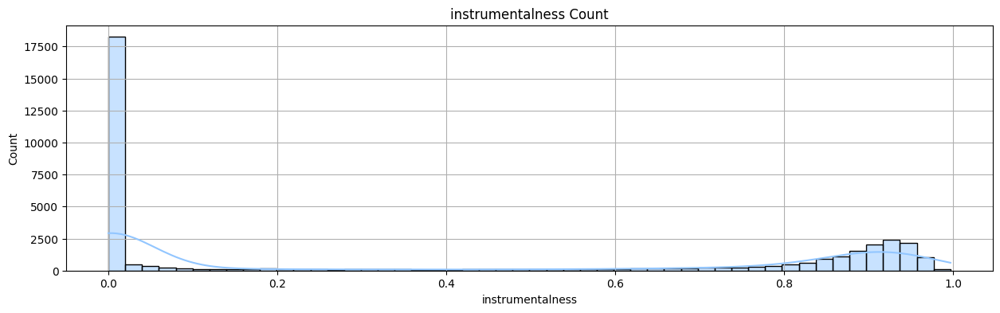

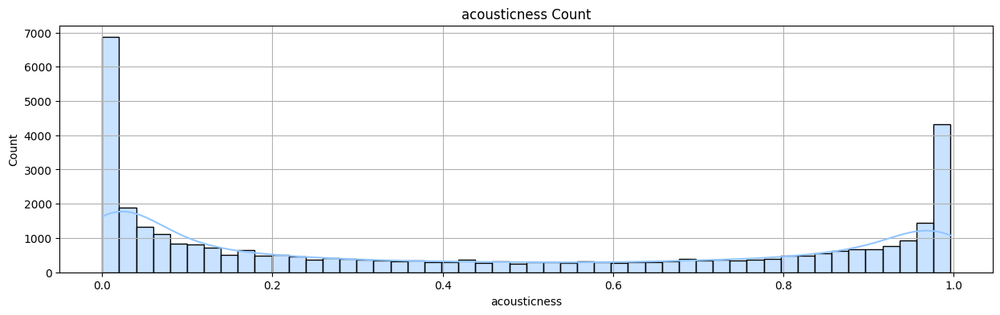

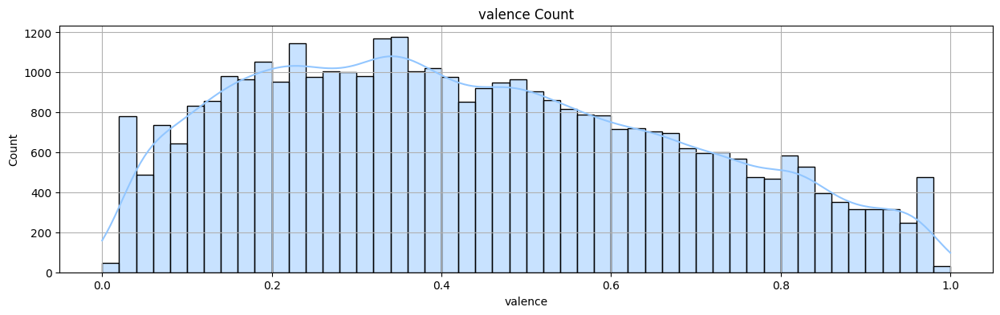

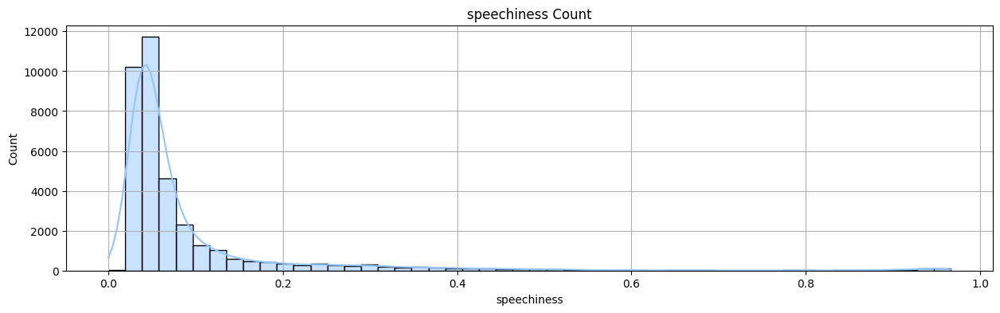

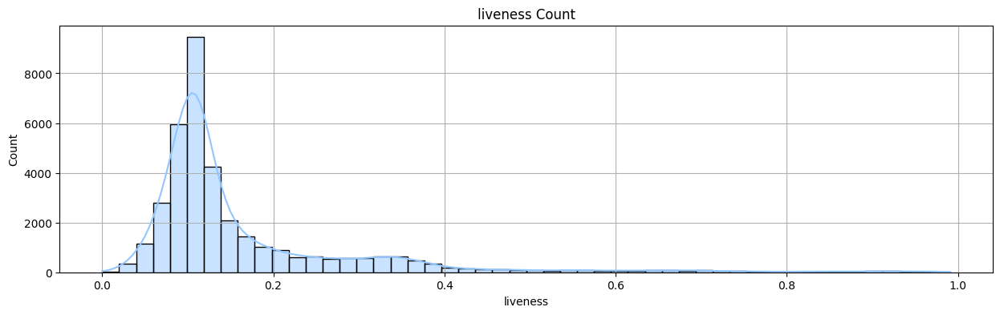

In [22]:
# Histogram Analysis of Continuous Variables
# ['explicit',
#  'duration_sec',
#  'track_popularity',
#  'followers',
#  'album_popularity',
#  'mode',
#  'key',
#  'time_signature',
#  'artist_genres_encoded']
for i in df.drop(['explicit', 'key', 'mode', 'time_signature', 'track_name', 'artists', 'album_name', 'artist_genres', 'artist_genres_encoded'],axis=1):
    fig, ax = plt.subplots(figsize=(15, 4))
    fig = sns.histplot(data=df, x=i, bins=50, kde=True)
    fig.set_title(f'{i} Count')
    fig.grid(True)
    plt.show()

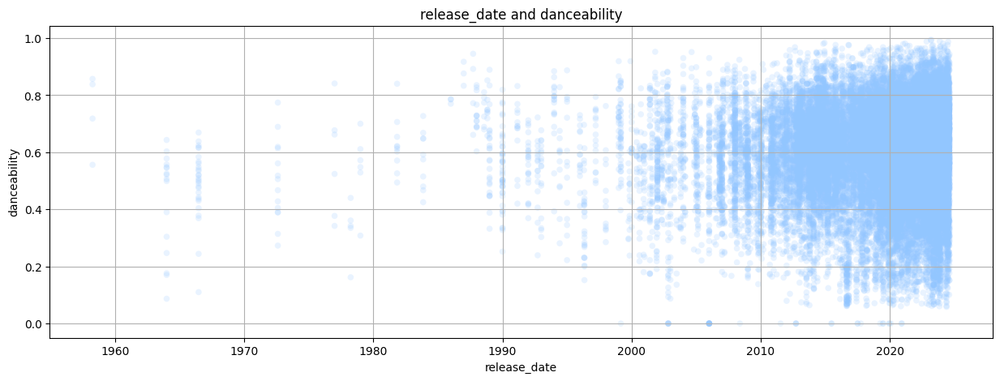

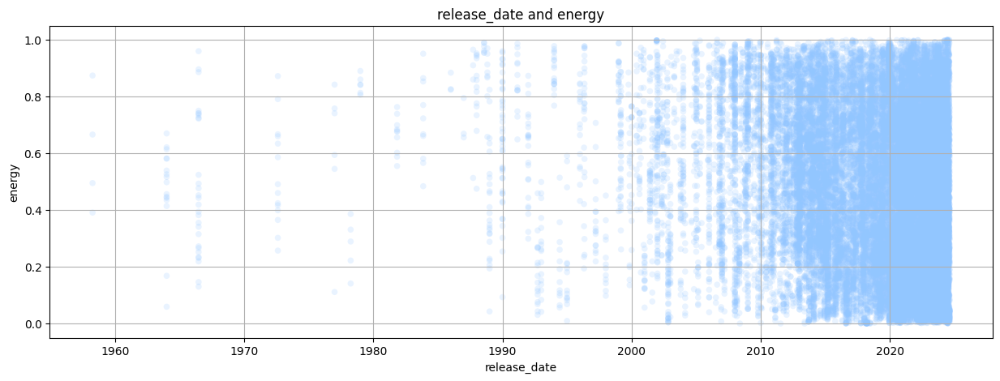

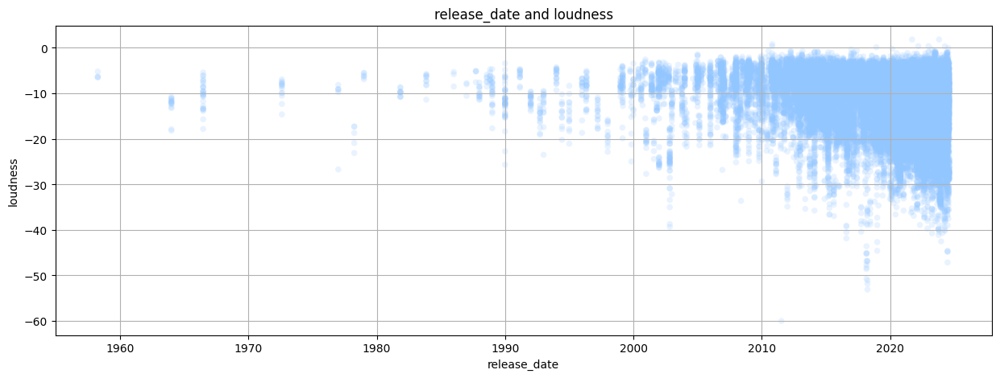

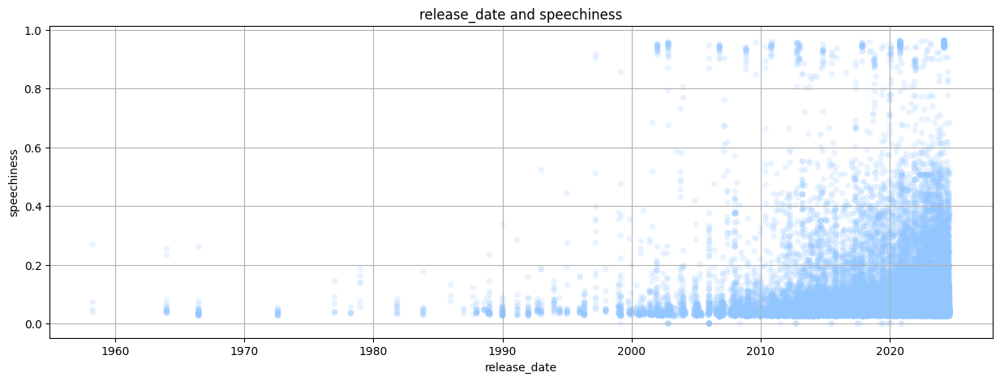

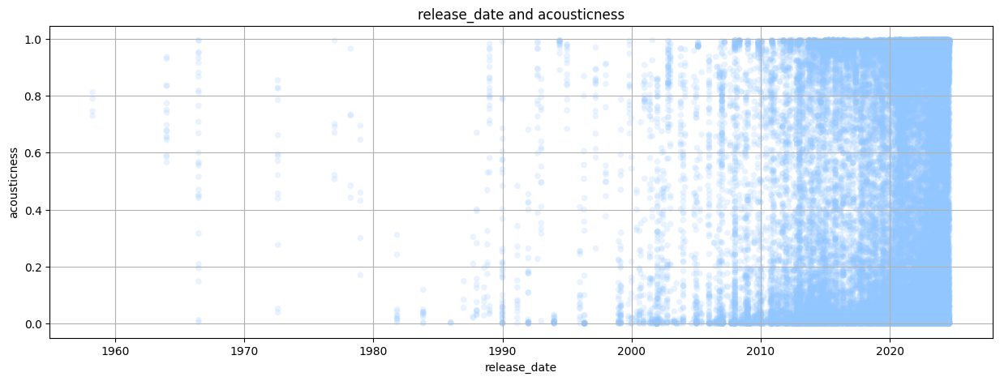

...

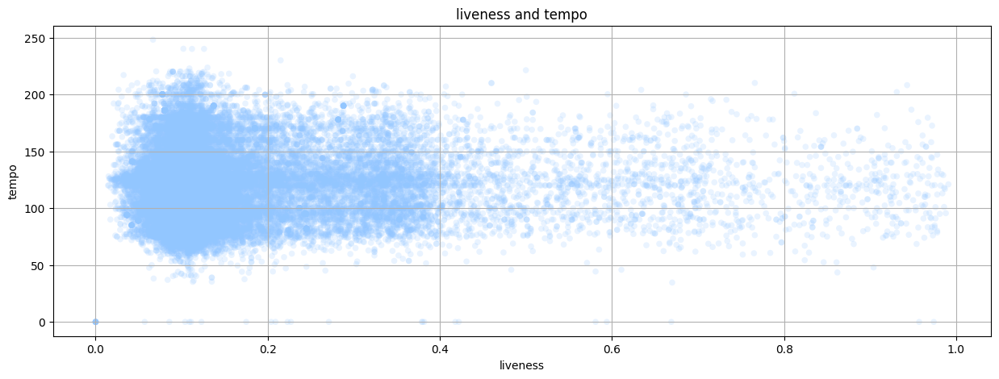

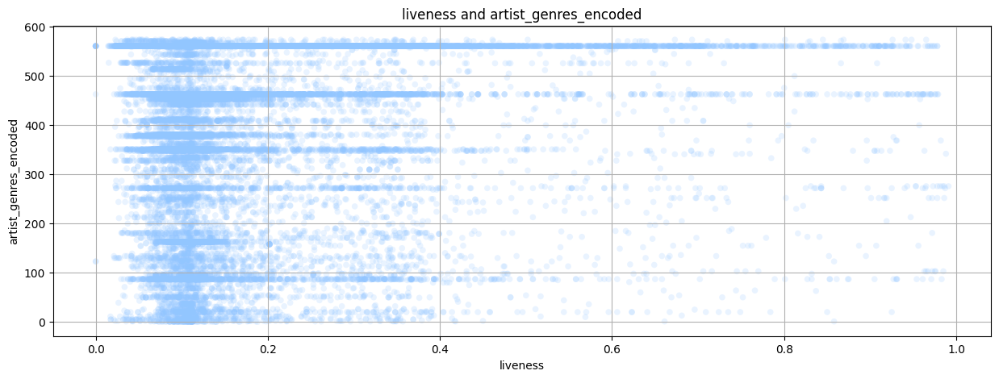

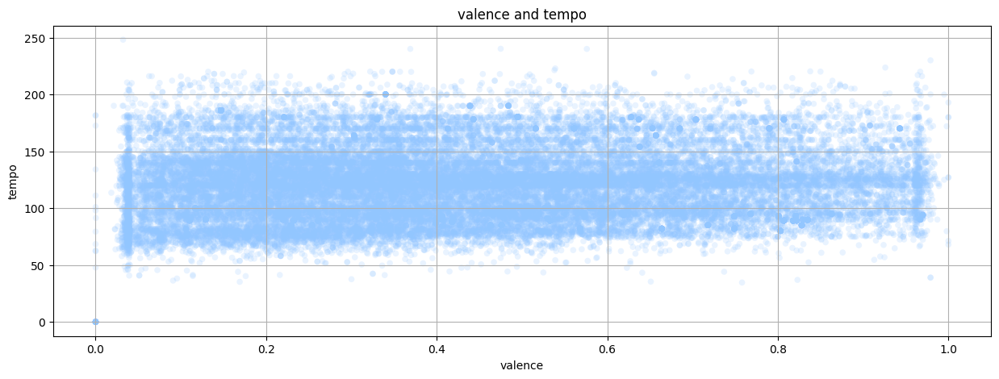

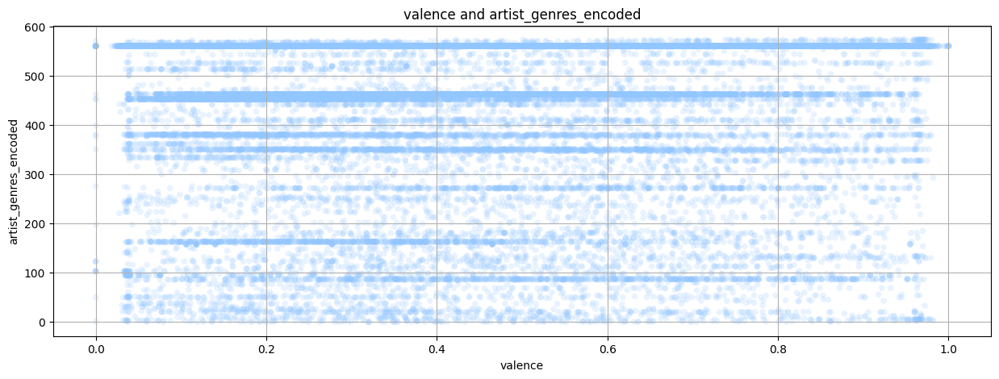

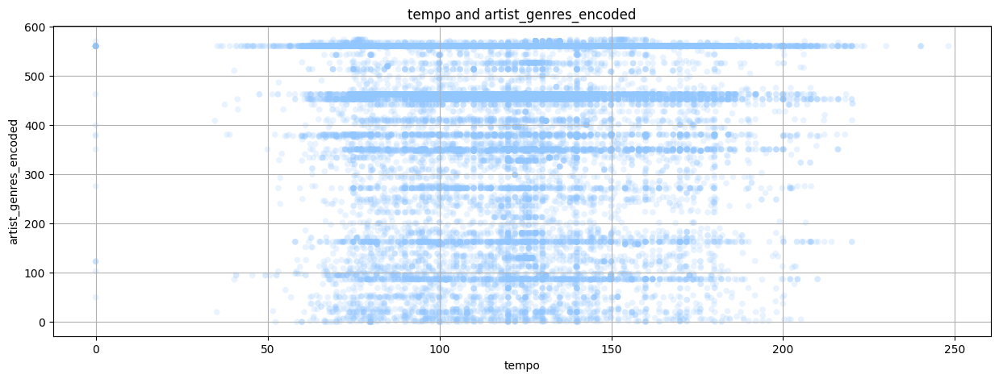

In [23]:
# Pairwise Scatter Plot Analysis of Music Attributes
from itertools import combinations
import matplotlib.patches as mpatches

for i, j in combinations(['release_date', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'artist_genres_encoded'], 2):
    fig, ax = plt.subplots(figsize=(15, 5))
    plt.scatter(df[i],df[j], alpha=0.2, s=30, edgecolor="none")
    plt.xlabel(i)
    plt.ylabel(j)
    plt.title(f'{i} and {j}')
    plt.grid(True)
    plt.show()

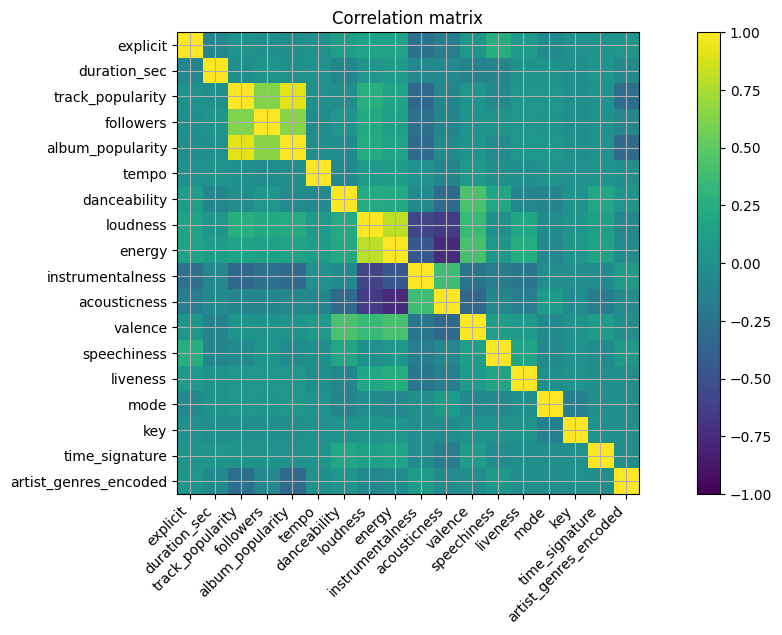

In [24]:
# Correlation matrix
import numpy as np

plt.figure(figsize=(15,6))
plt.imshow(df[df.select_dtypes(np.number).columns].corr(), vmin=-1, vmax=1)
plt.xticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns, rotation=45, ha='right')
plt.yticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns)
plt.title('Correlation matrix')
plt.grid(True)
plt.colorbar()

plt.show()

In [25]:
# Selecting training features (numerate columns)
features = df.select_dtypes(np.number).columns


In [26]:
df[features].head()

,explicit,duration_sec,track_popularity,followers,album_popularity,tempo,danceability,loudness,energy,instrumentalness,acousticness,valence,speechiness,liveness,mode,key,time_signature,artist_genres_encoded
0,0,199.793,9,8050,18,105.040,0.685,-17.359,0.1570,0.898,0.98300,0.318,0.0361,0.1110,1,0,4,453
1,0,127.509,2,4,2,128.066,0.761,-11.067,0.5340,0.870,0.03510,0.081,0.0806,0.3880,1,2,4,561
2,0,240.092,0,212,1,134.274,0.448,-28.440,0.0277,0.916,0.99500,0.345,0.0860,0.1060,1,5,4,561
3,0,191.893,0,118,0,140.879,0.542,-5.242,0.8980,0.000,0.56900,0.964,0.0322,0.2210,1,7,4,561
4,0,207.440,15,7656055,53,99.995,0.693,-5.696,0.8670,0.000,0.00287,0.661,0.0364,0.0739,0,5,4,87


In [27]:
# Rescaling data using Standard Scaler
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df[features])

df_scaled = pd.DataFrame(df_scaled, columns=features)

In [28]:
df_scaled.head()

,explicit,duration_sec,track_popularity,followers,album_popularity,tempo,danceability,loudness,energy,instrumentalness,acousticness,valence,speechiness,liveness,mode,key,time_signature,artist_genres_encoded
0,0.0,0.041520,0.09,6.816189e-05,0.18,0.423338,0.689135,0.689593,0.1570,0.900702,0.986948,0.318,0.037371,0.112008,1.0,0.000000,0.8,0.789199
1,0.0,0.026222,0.02,3.386926e-08,0.02,0.516139,0.765594,0.791348,0.5340,0.872618,0.035241,0.081,0.083437,0.391524,1.0,0.181818,0.8,0.977352
2,0.0,0.050049,0.00,1.795071e-06,0.01,0.541159,0.450704,0.510391,0.0277,0.918756,0.998996,0.345,0.089027,0.106963,1.0,0.454545,0.8,0.977352
3,0.0,0.039848,0.00,9.991433e-07,0.00,0.567779,0.545272,0.885550,0.8980,0.000000,0.571285,0.964,0.033333,0.223007,1.0,0.636364,0.8,0.977352
4,0.0,0.043138,0.15,6.482624e-02,0.53,0.403006,0.697183,0.878208,0.8670,0.000000,0.002882,0.661,0.037681,0.074571,0.0,0.454545,0.8,0.151568


In [29]:
len(features)

18

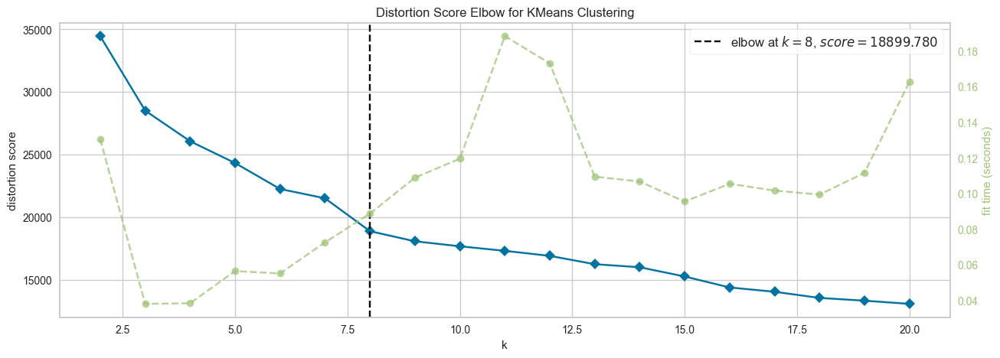

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [30]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Set random_state for reproducibility
kmeans = KMeans(n_init='auto', random_state=42)

plt.figure(figsize=(15, 5)) 
Elbow_M = KElbowVisualizer(kmeans, k=20)
Elbow_M.fit(df_scaled)
Elbow_M.show()


In [31]:
# Using KMeans model 11 clusters
model = KMeans(n_clusters=8, n_init='auto')
model.fit(df_scaled)

df_scaled["Cluster"] = model.labels_

In [32]:
# Visualizing the Clusters with PCA
import plotly.express as px 
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
embedding = pca.fit_transform(df_scaled)
projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
projection['title'] = df['track_name']
projection['genre'] = df['artist_genres']
projection['cluster'] = df_scaled['Cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genre'])
fig.show()

In [33]:
# Re-adding string features (Name, Artist, Genre, Album)
df_scaled = df_scaled.join(df[df.drop(features, axis=1).columns])

In [34]:
# Re-adding Year feature
df_scaled['release_date'] = df['release_date']

In [35]:
df_scaled.head()

,explicit,duration_sec,track_popularity,followers,album_popularity,tempo,danceability,loudness,energy,instrumentalness,...,key,time_signature,artist_genres_encoded,Cluster,artists,artist_genres,track_name,release_date,album_name,label
0,0.0,0.041520,0.09,6.816189e-05,0.18,0.423338,0.689135,0.689593,0.1570,0.900702,...,0.000000,0.8,0.789199,4,Molotov Cocktail Piano,piano cover,Soon You'Ll Get Better - Instrumental,2019-09-27,Mcp Performs Taylor Swift: Lover (Instrumental),CC Entertainment
1,0.0,0.026222,0.02,3.386926e-08,0.02,0.516139,0.765594,0.791348,0.5340,0.872618,...,0.181818,0.8,0.977352,7,zombiesoblessed,unknown,Beyond (Interlude),2024-06-13,Jeremy & The Boyz,4938647 Records DK
2,0.0,0.050049,0.00,1.795071e-06,0.01,0.541159,0.450704,0.510391,0.0277,0.918756,...,0.454545,0.8,0.977352,0,Jeremy Choi,unknown,Do You Think Of Me,2013-09-27,At The Door,Pison Contents
3,0.0,0.039848,0.00,9.991433e-07,0.00,0.567779,0.545272,0.885550,0.8980,0.000000,...,0.636364,0.8,0.977352,2,The One-Eyed Show,unknown,Tree Top Toby,2002-01-01,Unsure Of Direction,The One-Eyed Show
4,0.0,0.043138,0.15,6.482624e-02,0.53,0.403006,0.697183,0.878208,0.8670,0.000000,...,0.454545,0.8,0.151568,1,Joe Jonas,boy band,Just In Love,2019-05-09,Music From Chasing Happiness,Jonas Brothers


In [36]:
df_scaled.columns

Index(['explicit', 'duration_sec', 'track_popularity', 'followers',
       'album_popularity', 'tempo', 'danceability', 'loudness', 'energy',
       'instrumentalness', 'acousticness', 'valence', 'speechiness',
       'liveness', 'mode', 'key', 'time_signature', 'artist_genres_encoded',
       'Cluster', 'artists', 'artist_genres', 'track_name', 'release_date',
       'album_name', 'label'],
      dtype='object')

In [37]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
import os
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()

# Get Spotify API credentials from environment variables
client_id = os.getenv("Client_ID")
client_secret = os.getenv("Client_Secret")

# Setting up Spotipy with local environment variables
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=client_id,
                                                           client_secret=client_secret))


In [38]:
from collections import defaultdict
from scipy.spatial.distance import cdist
import pandas as pd
import numpy as np

# Defining function for finding song on Spotify
def find_song(name, artists):
    song_data = defaultdict()
    
    song_results = sp.search(q='track: {} artist: {}'.format(name, artists), limit=1)
    if not song_results['tracks']['items']:
        return None
    
    artist_results = sp.search(q='track: {} artist: {}'.format(name, artists), type='artist', limit=1)
    results = song_results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['track_name'] = [name]
    song_data['release_date'] = [pd.to_datetime(results['album']['release_date']).date()]
    song_data['explicit'] = [int(results['explicit'])]
    genres = artist_results['artists']['items'][0]['genres']
    song_data['artist_genres_encoded'] = [label_encoder.transform([genres[0]])] if genres else [label_encoder.transform(['unknown'])]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

# Selecting training features (numeric columns)
number_cols = df.select_dtypes(np.number).columns

# Defining function for getting song data
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['track_name'] == song['track_name']) 
                                 & (spotify_data['artists'] == song['artists'])].iloc[0]
        return song_data
    except IndexError:
        return find_song(song['track_name'], song['artists'])

# Defining function for getting mean vector of the song
def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print(f"Warning: {song['track_name']} does not exist in Spotify or in database")
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)
    
    song_matrix = np.array(song_vectors)
    return np.mean(song_matrix, axis=0)

# Defining function for transforming a list of dictionaries
def flatten_dict_list(dict_list):
    flattened_dict = defaultdict(list)
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
    return flattened_dict

# Defining function for getting song recommendations
def recommend_songs(song_list, spotify_data, n_songs=20):
    metadata_cols = ['track_name', 'artists', 'album_name', 'release_date', 'artist_genres']
    
    # Pre-processing and calculating the center vector
    song_dict = flatten_dict_list(song_list)
    song_center = get_mean_vector(song_list, spotify_data)
    
    # Scaling data
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    
    # Computing distances
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    # Getting recommended songs
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['track_name'].isin(song_dict['track_name'])]

    # Dropping duplicate songs by the same artist
    rec_songs = rec_songs.drop_duplicates(subset=['artists', 'track_name'])

    return rec_songs[metadata_cols].to_dict(orient='records')


In [44]:
pd.DataFrame(recommend_songs([{'track_name': 'Long Live', 'artists': 'Taylor Swift'}],  df_scaled))

,track_name,artists,album_name,release_date,artist_genres
0,Walls,Louis Tomlinson,Walls,2020-01-31,pop
1,Promit,Sabrina Stoica,Promit,2023-11-03,unknown
2,Don'T Forget Where You Belong (Originally Perf...,Paris Music,"Karaoke Hits One Direction, Vol. 2",2013-01-01,unknown
3,Sigma,Arko & The Guest House,Btsv,2024-02-23,unknown
4,Hit Parade,Little Miss Echo,Little Miss Echo,2024-06-07,unknown
5,Wonderland,Taylor Swift,1989 (Deluxe Edition),2014-10-27,pop
6,Dream Song - Live,Jeremy Burk,This Is The Generation (Live),2016-10-20,unknown
7,Walk Through The Stars,"Vasily Igor, Jérémy Barlozzo",Anthemic Pop Songs (Dreams Hopes & Triumphs),2022-06-13,unknown
8,I'Ll Always Remember You,Hannah Montana,Hannah Montana Forever,2010-01-01,pop
9,Paper Hearts,The Vamps,Acoustic By Connor,2022-09-09,boy band


In [ ]:
pd.DataFrame(recommend_songs([{'track_name': 'Photograph', 'artists': 'Ed Sheeran'}],  df_scaled))

,track_name,artists,album_name,release_date,artist_genres
0,Black And White - Stripped,Niall Horan,Black And White (Stripped),2020-05-22,pop
1,Blank Space (Taylor'S Version),Ana Done,1989 (Taylor'S Version) (The Violin Covers) [R...,2024-06-28,unknown
2,Afraid,Elle Carpenter,What Happens Now (Deluxe),2023-12-29,unknown
3,Invisible,Taylor Swift,Taylor Swift,2006-10-24,pop
4,The A Team,"Chester See, Andy Lange",The A Team,2013-01-07,viral pop
5,Sad Beautiful Tragic (Taylor'S Version),Taylor Swift,Red (Taylor'S Version),2021-11-12,pop
6,Eu Toco O Céu (Touch The Sky),Arianne,Outono,2017-07-28,adoracao
7,Your Side Of The Bed,Little Big Town,Tornado,2013-01-01,contemporary country
8,The Answer,Jeremy Thomas,Stand In Faith,2023-10-20,unknown
9,Only You,Jeremy Thomas,Stand In Faith,2023-10-20,unknown


In [ ]:
pd.DataFrame(recommend_songs([{'track_name': 'Thinking Out Loud', 'artists': 'Ed Sheeran'}],  df_scaled))

,track_name,artists,album_name,release_date,artist_genres
0,All That Love,Sabrina Weeks & Swing Cat Bounce,Tales From Lenny'S Diner,2010-09-14,unknown
1,Hate You Song,Olivia Evans,Level,2021-11-05,unknown
2,Blue Moon,High School Music Band,Olivia Newton Tribute,2022-08-09,unknown
3,Before We Go (Reprise),"Joriah Kwamé, Savannah Fisher",Little Miss Perfect: The Musical (Demo),2021-08-02,unknown
4,Daylight,Harry Styles,Harry'S House,2022-05-20,pop
5,Alone Sometimes,Sabrina Song,Undone,2019-07-12,unknown
6,Sugar,Olivia Mae,Sugar,2024-05-22,unknown
7,"I Think I Kinda, You Know - Duet","Olivia Rodrigo, Joshua Bassett, Disney","I Think I Kinda, You Know (From ""High School M...",2019-11-08,pop
8,"I Think I Kinda, You Know - From ""High School ...","Olivia Rodrigo, Joshua Bassett, Disney",Best Of High School Musical: The Musical: The ...,2021-07-16,pop
9,Don'T Be Afraid Of Halloween,Little Angel,Happy Halloween!,2022-09-23,preschool children's music


In [ ]:
pd.DataFrame(recommend_songs([{'track_name': 'One Thing', 'artists': 'One Direction'}],  df_scaled))

,track_name,artists,album_name,release_date,artist_genres
0,10 Years From Now,DJ Sabrina The Teenage DJ,Spellbinding Singles!,2019-05-29,unknown
1,Mine - Pop Mix,Taylor Swift,Speak Now (Deluxe Edition),2010-10-25,pop
2,Girl At Home (Taylor'S Version),Taylor Swift,Red (Taylor'S Version),2021-11-12,pop
3,Leave Before You Love Me,"Marshmello, Jonas Brothers",The Family Business,2023-02-17,boy band
4,Leave Before You Love Me (With Jonas Brothers),"Marshmello, Jonas Brothers",Leave Before You Love Me,2021-05-21,brostep
5,Be There,Sabrina Lee,Be There,2020-11-13,unknown
6,Reasons,Sabrina Johnston,"The Singles: 1980-1995, Vol. 1",2015-07-02,diva house
7,Story Of My Life - House Style Radio Cut,Dionny,Story Of My Life: Tribute To One Direction (Li...,2014-04-02,unknown
8,Camera - Eurovision Mix,"Sabrina, Nick Doukakis",Camera,2002-06-08,unknown
9,Rock City Girl,Arianna Tsar,Rock City Girl,2023-07-07,unknown


In [ ]:
# Asking for recommendations based on Lauv's I Like Me Better
pd.DataFrame(recommend_songs([{'track_name': 'I Like Me Better', 'artists': 'Lauv'}],  df_scaled))

,track_name,artists,album_name,release_date,artist_genres
0,Sneg Wintertime,Little Drummer Boy,Little Christmas Mix,2023-12-24,unknown
1,Kghzi,"Misho, Armen Hyusnunts",Btsaxndir,2015-10-24,armenian hip hop
2,Olivia,dee holt,Olivia (Acoustic Version),2022-07-01,unknown
3,1000 Nights (Feat. Meek Mill & A Boogie Wit Da...,"Ed Sheeran, Meek Mill, A Boogie Wit da Hoodie",No.6 Collaborations Project,2019-07-12,pop
4,Road,Jade,Directions,2024-07-09,unknown
5,Billi Eilish Remix,A-Game,Billi Eilish Remix,2022-10-26,indie hip hop
6,Prisoner In Love,"Kalbata, Mixmonster, Little John",Prisoner In Love (Feat. Little John),2014-03-17,unknown
7,Mon Promis,sabrina,Love Agenda,2021-11-16,unknown
8,No Way,"Jeremy Ryan, Culture School",Kobeshaq,2024-04-28,unknown
9,Dans La Nuit,Lauviah,Dans La Nuit,2021-03-07,unknown


In [ ]:
# Asking for recommendations based on Little Mix's Secret Love Song
pd.DataFrame(recommend_songs([{'track_name': 'Secret Love Song - Get Weird Tour Live From The Sse Arena, Wembley', 'artists': 'Little Mix'}],  df_scaled))


,track_name,artists,album_name,release_date,artist_genres
0,Ours - Live/2011,Taylor Swift,Speak Now World Tour Live,2010-10-25,pop
1,A Hard Rain'S A-Gonna Fall - Live At Carnegie ...,Bob Dylan,No Direction Home: Bootleg Volume 7 (Movie Sou...,1966-06-23,classic rock
2,Something In The Orange - Live From Spotify St...,Niall Horan,Live From Spotify Studios,2024-02-13,pop
3,Daylight - Live From Paris,Taylor Swift,Daylight (Live From Paris),2020-05-17,pop
4,Anyone - Live From The 62Nd Grammy ® Awards,Demi Lovato,Anyone (Live From The 62Nd Grammy ® Awards),2020-02-06,pop
5,Drops Of Jupiter - Live/2011,Taylor Swift,Speak Now World Tour Live,2010-10-25,pop
6,Bette Davis Eyes - Live/2011,Taylor Swift,Speak Now World Tour Live,2010-10-25,pop
7,Georgia On My Mind (Live),"Jeremy Monteiro, Wesley Gehring, Shawn Letts, ...",Organ Quartet Live Upon Nassim Hill,2024-03-18,unknown
8,Cornelia Street - Live From Paris,Taylor Swift,Cornelia Street (Live From Paris),2020-05-18,pop
9,One - Live And In Session,Ed Sheeran,Live And In Session,2014-08-11,pop
